# Finding Coronavirus Hotspots in Texas <br>
*(To view notebook with rendered maps, visit https://nbviewer.jupyter.org/github/Shikhar-G/Coursera_Capstone/blob/master/Final%20Project.ipynb)*

#### In this project, we aim to use exploratory data analysis and machine learning techniques to examine if different types of popular venues present in a Texas county make an impact on the Coronavirus infection rate, and we also create a ranked list of the most "dangerous" types of venues based on our findings.

## 1) Finding infection rates for all counties in Texas

#### We'll use the coronavirus case data along with county location data to find infection rates for each county.

In [2]:
# !pip install bs4 
# !pip install folium
# !pip install geopy
# !pip install matplotlib
# !pip install sklearn
# !pip install xlrd
import pandas as pd
import numpy as np
from scipy.spatial.distance import cdist 
from sklearn.preprocessing import MinMaxScaler
from geopy.geocoders import Nominatim # to get latitude, longitude
import folium # map rendering library
import json # library to handle JSON files
import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe
import matplotlib.cm as cm # Matplotlib and associated plotting modules
import matplotlib.colors as colors
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans # import k-means from clustering stage
print('Libraries imported')

Libraries imported


First, we'll get the data for coronavirus cases in each Texas county and clean it.

In [3]:
# Read in the data
county_df = pd.read_excel('data/COVID-Data.xlsx', index_col = 0, header = 2).iloc[1:-11, [0,-1]].reset_index()
county_df.rename(columns={'Cases 06-21' : 'Current Total'}, inplace=True)

# Make numbers numerical
county_df[['Current Total', 'Population']] = county_df[['Current Total', 'Population']].astype(int)

print(county_df.dtypes)
county_df.head()

FileNotFoundError: [Errno 2] No such file or directory: 'data/COVID-Data.xlsx'

Then, we'll calculate infection rates and sort counties by infection rate (%).

In [ ]:
county_df['Infection Rate'] = (100 * county_df['Current Total']/county_df['Population'].astype(float))
county_df.sort_values(by='Infection Rate', ascending=False, ignore_index=True, inplace = True)
county_df.head()

Next, we'll create a chloropleth map of Texas based on infection rates.

In [ ]:
# read in geojson data
county_geo = r'data/Texas_County_Boundaries.json'

# get coordinates for texas
address = 'TX'
geolocator = Nominatim(user_agent="tx_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude

# Create scale for map
threshold_scale = np.linspace(county_df['Infection Rate'].min(),
                              county_df['Infection Rate'].max(),
                              10, dtype=float)
threshold_scale = threshold_scale.tolist() 

# visualize map
texas_map = folium.Map(location=[latitude, longitude], zoom_start=6)

# generate choropleth map using the infection rates of each county
choropleth = folium.Choropleth(
    geo_data=county_geo,
    data=county_df.iloc[:-1],
    columns=['County Name', 'Infection Rate'],
    key_on='feature.properties.CNTY_NM',
    threshold_scale=threshold_scale,
    nan_fill_color='black',
    nan_fill_opacity=0.3,
    fill_color='YlOrRd', 
    fill_opacity=0.8, 
    line_opacity=0.2,
    legend_name='Coronavirus Rates in Texas (%)').add_to(texas_map)

# add county names
style_function = "font-size: 12px; font-weight: bold"
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['CNTY_NM'], style=style_function, labels=False))

# create a layer control
folium.LayerControl().add_to(texas_map)

# display map
print(r"(Note: No available data for areas marked in gray)")
texas_map

## 2) Finding the most popular venues for each county

#### We'll use the Foursquare API to find popular venues in every county.

First, we have to obtain coordinates for each county from the Texas Counties Centroid Dataset.

In [5]:
coords_df = pd.read_csv('data/Texas_Counties_Centroid_Map.csv')
coords_df = coords_df[['CNTY_NM','X (Lat)', 'Y (Long)']]
# The latitude and longitude values should be flipped (they are mislabeled on the dataset)
coords_df.rename(columns={'X (Lat)' : 'Longitude', 'Y (Long)' : 'Latitude', 'CNTY_NM' : 'County'}, inplace=True)
coords_df.head()

,County,Longitude,Latitude
0,Gonzales,-97.492799,29.456415
1,Jim Hogg,-98.697292,27.043405
2,Kenedy,-97.681378,26.924094
3,Lee,-96.965687,30.310651
4,Henderson,-95.853568,32.211881


Then we'll use the Foursquare API to gather venues from every county (we split the data set and use 2 calls because too many calls overload the server.

In [11]:
# Foursquare credentials
CLIENT_ID = 'V5DBZ3XY5I3NZ1AU1QMBTKNEZ2CO3ZSHDSTLLXOYYRXLRJAF' # your Foursquare ID
CLIENT_SECRET= 'JIGYHOVPTRHIZEXJ0PHV2WAEV4O3WRVNEQASRN3T2CKWK5HM' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

In [48]:
LIMIT = 100 
# Function to get venues from each county using foursquare
def getNearbyVenues(codes, latitudes, longitudes, radius=25000):
    
    venues_list=[]
    for name, lat, lng in zip(codes, latitudes, longitudes):
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)

        results = requests.get(url).json()["response"]['groups'][0]['items']

        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['County', 
                  'County Latitude', 
                  'County Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']

    return(nearby_venues)

In [49]:
# Split data set and get 2 dataframes with all the data
county_venues = getNearbyVenues(codes=coords_df['County'].loc[0:120],
                                   latitudes=coords_df['Latitude'].loc[0:120],
                                   longitudes=coords_df['Longitude'].loc[0:120]
                                  )
county_venues2 = getNearbyVenues(codes=coords_df['County'].loc[121:],
                                   latitudes=coords_df['Latitude'].loc[121:],
                                   longitudes=coords_df['Longitude'].loc[121:]
                                  )
county_venues.head()

,County,County Latitude,County Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Gonzales,29.456415,-97.492799,La Bella Tavola,29.502478,-97.453545,Italian Restaurant
1,Gonzales,29.456415,-97.492799,Baker Boys BBQ,29.519840,-97.432945,BBQ Joint
2,Gonzales,29.456415,-97.492799,H-E-B,29.517765,-97.452753,Grocery Store
3,Gonzales,29.456415,-97.492799,Whataburger,29.514068,-97.458722,Burger Joint
4,Gonzales,29.456415,-97.492799,Dairy Queen,29.498306,-97.450968,Ice Cream Shop


In [50]:
# Concatenate the data into one dataframe
county_venues = county_venues.append(county_venues2, ignore_index = True)
print("There is data for {} counties and {} unique categories of venues".format(county_venues['County'].unique().shape[0],
                                                                     county_venues['Venue Category'].unique().shape[0]))
county_venues.groupby('County').count()


There is data for 252 counties and 316 unique categories of venues


,County Latitude,County Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
County,,,,,,
Anderson,42,42,42,42,42,42
Andrews,15,15,15,15,15,15
Angelina,90,90,90,90,90,90
Aransas,60,60,60,60,60,60
Archer,7,7,7,7,7,7
...,...,...,...,...,...,...
Wood,37,37,37,37,37,37
Yoakum,15,15,15,15,15,15
Young,27,27,27,27,27,27


Then, let's use one hot encoding to separate each county's popular venues, and get frequencies.

In [65]:
# one hot encoding
county_onehot = pd.get_dummies(county_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
county_onehot['County'] = county_venues['County'] 

# move county column to the first column
fixed_columns = [county_onehot.columns[-1]] + list(county_onehot.columns[:-1])
county_onehot = county_onehot[fixed_columns]

print(county_onehot.shape)
county_onehot.head()

(9517, 317)


,County,Accessories Store,Adult Boutique,Airport,Airport Terminal,American Restaurant,Animal Shelter,Antique Shop,Aquarium,Arcade,...,Warehouse Store,Water Park,Whisky Bar,Wine Bar,Wine Shop,Winery,Wings Joint,Women's Store,Yoga Studio,Zoo
0,Gonzales,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Gonzales,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Gonzales,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Gonzales,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Gonzales,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [70]:
county_grouped = county_onehot.groupby('County').mean().reset_index()
county_grouped.head()

,County,Accessories Store,Adult Boutique,Airport,Airport Terminal,American Restaurant,Animal Shelter,Antique Shop,Aquarium,Arcade,...,Warehouse Store,Water Park,Whisky Bar,Wine Bar,Wine Shop,Winery,Wings Joint,Women's Store,Yoga Studio,Zoo
0,Anderson,0.0,0.0,0.0,0.0,0.023810,0.0,0.0,0.000000,0.0,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.023810,0.0,0.0,0.000000
1,Andrews,0.0,0.0,0.0,0.0,0.133333,0.0,0.0,0.000000,0.0,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000
2,Angelina,0.0,0.0,0.0,0.0,0.022222,0.0,0.0,0.000000,0.0,...,0.011111,0.0,0.0,0.011111,0.0,0.0,0.011111,0.0,0.0,0.011111
3,Aransas,0.0,0.0,0.0,0.0,0.033333,0.0,0.0,0.016667,0.0,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000
4,Archer,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000


Now we'll rank each type of venue for every county by frequency.

In [195]:
num_top_venues = 10

# function to sort and return the top 10 most popular venues
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['County']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
county_venues_sorted = pd.DataFrame(columns=columns)
county_venues_sorted['County'] = county_grouped['County']

for ind in np.arange(county_grouped.shape[0]):
    county_venues_sorted.iloc[ind, 1:] = return_most_common_venues(county_grouped.iloc[ind, :], num_top_venues)

county_venues_sorted.head()

,County,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Anderson,Pizza Place,Mexican Restaurant,Burger Joint,Clothing Store,BBQ Joint,Discount Store,Pharmacy,Fried Chicken Joint,Coffee Shop,Gas Station
1,Andrews,Convenience Store,American Restaurant,Deli / Bodega,Fast Food Restaurant,Grocery Store,Coffee Shop,Sandwich Place,Truck Stop,Discount Store,Ice Cream Shop
2,Angelina,Discount Store,Fast Food Restaurant,Sandwich Place,Mexican Restaurant,Gas Station,Burger Joint,Restaurant,Grocery Store,Coffee Shop,Hardware Store
3,Aransas,Convenience Store,Hotel,Seafood Restaurant,Harbor / Marina,Park,Bar,Fishing Spot,Chinese Restaurant,Pizza Place,American Restaurant
4,Archer,Ice Cream Shop,Post Office,Spa,Other Repair Shop,Outdoors & Recreation,BBQ Joint,Dance Studio,Fish & Chips Shop,Factory,Falafel Restaurant


## 3) Finding relationships between venues and infection rates through clustering

#### We'll use k-means clustering to find any relationships between venues and infection rates.

First let's add infection rates to the popular venues dataframe.

In [196]:
# rename column for easier merging
county_df.rename(columns={'County Name' : 'County'})

# join coronavirus stats df with venues df
county_venues_sorted = county_venues_sorted.merge(county_df, on='County')

# remove current total and population, and move infection rate to the front
columns = list(county_venues_sorted.columns[[0, -1]]) + list(county_venues_sorted.columns[1:11])
county_venues_sorted = county_venues_sorted[columns]
county_venues_sorted.head()

,County,Infection Rate,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Andrews,0.197584,Convenience Store,American Restaurant,Deli / Bodega,Fast Food Restaurant,Grocery Store,Coffee Shop,Sandwich Place,Truck Stop,Discount Store,Ice Cream Shop
1,Angelina,0.420182,Discount Store,Fast Food Restaurant,Sandwich Place,Mexican Restaurant,Gas Station,Burger Joint,Restaurant,Grocery Store,Coffee Shop,Hardware Store
2,Aransas,0.025272,Convenience Store,Hotel,Seafood Restaurant,Harbor / Marina,Park,Bar,Fishing Spot,Chinese Restaurant,Pizza Place,American Restaurant
3,Archer,0.035954,Ice Cream Shop,Post Office,Spa,Other Repair Shop,Outdoors & Recreation,BBQ Joint,Dance Studio,Fish & Chips Shop,Factory,Falafel Restaurant
4,Armstrong,0.154004,Convenience Store,Ice Cream Shop,Sandwich Place,Business Service,Gas Station,Food,Food & Drink Shop,Flower Shop,Flea Market,Fishing Spot


Now we'll transform our categorical data to numerical and scale it for clustering <br>
Some code adapted from https://blog.cambridgespark.com/how-to-determine-the-optimal-number-of-clusters-for-k-means-clustering-14f27070048f and https://www.geeksforgeeks.org/elbow-method-for-optimal-value-of-k-in-kmeans/

In [197]:
# Make all values numerical
county_clustering = county_venues_sorted.drop('County', axis=1)
categorical_features = county_clustering.columns[1:]
for col in categorical_features:
    dummies = pd.get_dummies(county_clustering[col], prefix="", prefix_sep="")
    county_clustering = pd.concat([county_clustering, dummies], axis=1)
    county_clustering.drop(col, axis=1, inplace=True)
county_clustering.head()

,Infection Rate,American Restaurant,Art Gallery,BBQ Joint,Bed & Breakfast,Burger Joint,Business Service,Campground,Clothing Store,Coffee Shop,...,Sports Bar,State / Provincial Park,Steakhouse,Supermarket,Sushi Restaurant,Truck Stop,Video Store,Vietnamese Restaurant,Wings Joint,Zoo
0,0.197584,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0.420182,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0.025272,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0.035954,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0.154004,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


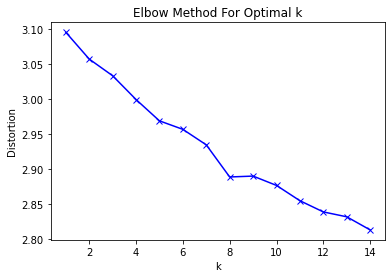

In [200]:
# scale the data
mms = MinMaxScaler()
mms.fit(county_clustering)
county_clustering_tf = mms.transform(county_clustering)
county_clustering_tf

# use distortion method (mapping euclidean distance) for determining optimal k
distortions = [] 
K = range(1,15)
for k in K:
    km = KMeans(init = "k-means++", n_clusters=k, n_init=5).fit(county_clustering_tf) 
    km.fit(county_clustering_tf) 
    
    distortions.append(sum(np.min(cdist(county_clustering_tf, km.cluster_centers_, 
                      'euclidean'),axis=1)) / county_clustering_tf.shape[0]) 
    
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('Elbow Method For Optimal k')
plt.show()

We can see that the optimal k value here would be 8 clusters.

In [201]:
# Generate clusters
km = KMeans(init = "k-means++", n_clusters=8, n_init=12).fit(county_clustering_tf) 
km.fit(county_clustering_tf) 

# Insert clusters into table
county_venues_sorted.insert(0, 'Cluster Labels', km.labels_)
county_venues_sorted.groupby('Cluster Labels').count()

,County,Infection Rate,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
Cluster Labels,,,,,,,,,,,,
0,32,32,32,32,32,32,32,32,32,32,32,32
1,36,36,36,36,36,36,36,36,36,36,36,36
2,23,23,23,23,23,23,23,23,23,23,23,23
3,62,62,62,62,62,62,62,62,62,62,62,62
4,36,36,36,36,36,36,36,36,36,36,36,36
5,41,41,41,41,41,41,41,41,41,41,41,41
6,11,11,11,11,11,11,11,11,11,11,11,11
7,9,9,9,9,9,9,9,9,9,9,9,9


In [202]:
# Get clusters for infection rates
infections = county_venues_sorted[['Cluster Labels', 'Infection Rate']].groupby('Cluster Labels').mean()

In [203]:
# Get venues and cluster labels 
columns = list(county_venues_sorted.columns[3:]) + [county_venues_sorted.columns[0]]
# Get most common values for each venue
venues = county_venues_sorted[columns].groupby('Cluster Labels').agg(lambda x:x.value_counts().index[0])
venues = infections.join(venues)
venues

,Infection Rate,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
Cluster Labels,,,,,,,,,,,
0,0.408361,Mexican Restaurant,Burger Joint,Convenience Store,American Restaurant,Fast Food Restaurant,Grocery Store,Pizza Place,Coffee Shop,American Restaurant,Fast Food Restaurant
1,0.204659,Mexican Restaurant,Fast Food Restaurant,American Restaurant,Burger Joint,Sandwich Place,Ice Cream Shop,American Restaurant,Grocery Store,Sandwich Place,Ice Cream Shop
2,0.286926,American Restaurant,Mexican Restaurant,Ice Cream Shop,Campground,Discount Store,Zoo,Fish & Chips Shop,Factory,Falafel Restaurant,Farm
3,0.274147,Coffee Shop,Mexican Restaurant,American Restaurant,Fast Food Restaurant,Pizza Place,Sandwich Place,Discount Store,Fast Food Restaurant,Café,Falafel Restaurant
4,0.185823,Convenience Store,Discount Store,Ice Cream Shop,Sandwich Place,Discount Store,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant
5,0.471894,Fast Food Restaurant,Discount Store,Sandwich Place,Pizza Place,Discount Store,Sandwich Place,Hotel,Mexican Restaurant,Gas Station,BBQ Joint
6,0.073975,Ice Cream Shop,Home Service,Zoo,Zoo,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field
7,0.117144,Convenience Store,Zoo,Zoo,Fishing Spot,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Fish & Chips Shop


As we can see, clusters with the higher infection rates (like clusters 0 and 5) also have many food places and stores as popular venues, while clusters with lower rates (like clusters 6 and 7), seem to have farms and zoos as more popular and have less food places.

Now, let's visualize these clusters.

In [206]:
# visualize map
texas_map_clusters = folium.Map(location=[latitude, longitude], zoom_start=6)

threshold_scale = np.linspace(0, 8, 9, dtype=float)

# generate choropleth map using the cluster labels of each county
choropleth = folium.Choropleth(
    geo_data=county_geo,
    data=county_venues_sorted,
    columns=['County', 'Cluster Labels'],
    key_on='feature.properties.CNTY_NM',
    threshold_scale=threshold_scale,
    nan_fill_color='black',
    nan_fill_opacity=0.3,
    fill_color='Spectral', 
    fill_opacity=0.8, 
    line_opacity=0.2,
    legend_name='Clusters').add_to(texas_map_clusters)

# add county names
style_function = "font-size: 12px; font-weight: bold"
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['CNTY_NM'], style=style_function, labels=False))

# create a layer control
folium.LayerControl().add_to(texas_map_clusters)

# display map
print(r"(Note: No available data for areas marked in gray)")
texas_map_clusters

(Note: No available data for areas marked in gray)


## 4) Ranking venues based on infection rates

First, we'll get the frequency of every type of venue in the list

In [351]:
# Dataframe with only venues
allvenues = county_venues_sorted.drop(columns=['Infection Rate', 'County', 'Cluster Labels'])

# Get frequency of every venue in the dataframe
venueFreq = {}
for row in allvenues.itertuples(index=False):
    for item in row:
        if venueFreq.get(item) == None:
            venueFreq[item] = 1
        else:
            venueFreq[item] += 1
            
# Create new dataframe of frequencies
freq_df = pd.DataFrame.from_dict(venueFreq, orient='index', columns=['Frequency'])
freq_df.head()

,Frequency
Convenience Store,108
American Restaurant,115
Deli / Bodega,11
Fast Food Restaurant,198
Grocery Store,79


Now we'll calculate a score for each venue, calculating it by multiplying the rank of the venue (1st to 10th is on a scale of 1 to 0.1) multiplied by the normalized infection rate of the county it is present in (and this total will be divided by the total frequency). The higher the average weighted score, the more likely it is to contribute to the coronavirus infection rate.

In [353]:
# Add a new column for scoring, populated with 0s
freq_df['Weighted Score'] = list(np.zeros(freq_df.shape[0]))

# Weight 1st most popular as 1 and 10th as 0.1
venueWeights = list(np.linspace(1, 0.1, 10))

# Normalize infection rates using min max scaling
infectionWeights = county_venues_sorted[['Infection Rate']].values
min_max_scaler = MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(infectionWeights)
infectionWeights = list(x_scaled[:,0])

# Calculate weighted scores of each
for infectionIndex, row in enumerate(allvenues.itertuples(index=False)):
     for venueIndex, item in enumerate(row):
            freq_df.loc[item, 'Weighted Score'] += venueWeights[venueIndex] * infectionWeights[infectionIndex]
            
# Get average weighted score (multiplied by 100 for better readability)
freq_df['Weighted Score'] = (freq_df['Weighted Score'] / freq_df['Frequency']) * 100
freq_df.head()

,Frequency,Weighted Score
Convenience Store,108,5.147593
American Restaurant,115,4.680522
Deli / Bodega,11,1.954918
Fast Food Restaurant,198,4.999459
Grocery Store,79,3.206067


Finally, we drop venues that are infrequent and create a final ranking of venues.

In [354]:
# Remove values that don't show up frequently in the list (Less than 5 times)
freq_df = freq_df[freq_df['Frequency'] >= 5]

# Sort values in descending order and drop frequency column
freq_df.sort_values(ascending=False, by='Weighted Score', inplace=True)
freq_df.drop(columns='Frequency', inplace = True)

# Not a valid type of venue
freq_df.drop(index='Intersection', inplace = True)

freq_df.rename(columns={'Weighted Score' : 'Average Weighted Score'}, inplace=True)

freq_df.head(10)

,Average Weighted Score
Chinese Restaurant,7.391056
Video Store,5.485156
Discount Store,5.459786
Hotel,5.405881
Mexican Restaurant,5.269406
Airport,5.175274
Convenience Store,5.147593
Fast Food Restaurant,4.999459
Department Store,4.976926
Pizza Place,4.972640


#### Thus as the data suggests, the venues that may contribute the most to coronavirus infection rates, and thus may be "hotspots", include restaurants, stores, hotels, and airports, confirming our initial observations from the clustering.